# Find patterns by site

- These errors are based on A and B: the same errors but repeated across multiple buildings at the same time.
- In range errors (C): 0.1 <= `rmsle_scaled` <= 0.3
  - multiple buiding in range long term (C1): time_consequitve_error > 3 days
  - multiple building in range mid term (C2): 1 day < time_consequitve_error <= 3 days
  - multiple building in range short term (C3): time_consequitve_error = 1
  - multiple building in range fluctuatiom (C4):
- Out of range errors (D): `rmsle_scaled` > 0.3
  - multiple buiding out of range long term (D1): time_consequitve_error > 3 days
  - multiple building out of range mid term (D2): 1 day < time_consequitve_error <= 3 days
  - multiple building out of range short term (D3): time_consequitve_error = 1
  - multiple building out of range fluctuatiom (D4):

In [1]:
import sys
sys.path.append("..\\source\\")
import utils as utils
import glob

# Data and numbers
import pandas as pd
import numpy as np
import datetime as dt
from sklearn.preprocessing import MinMaxScaler

# Visualization
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import ticker
import matplotlib.dates as mdates
%matplotlib inline

In [2]:
path_data = "..\\data\\processed\\summary\\"
path_leak = "..\\data\\leaked\\"
path_meta = "..\\data\\original\\metadata\\"
path_arrays = "..\\data\\processed\\arrays\\"
path_res = "..\\results\\by_bdg\\"

# Functions

In [3]:
def heatmaps_comp(df,df_bool):

    """This function plots two heatmaps side by side:
        - The original heatmap\n
        - A heatmap where only values over ´tresh_error´ are colored\n

        df: original values for a meter-site.
        df_bool: masked df for that meter-site, where only values over `tresh_error` are 1 (otherwise, 0)\n
    """
    
    fig, axes = plt.subplots(1, 2, sharex = True, sharey=True, figsize=(16,8))
    axes = axes.flatten()

    # Get the data
    y = np.linspace(0, len(df), len(df)+1)
    x = pd.date_range(start='2017-01-01', end='2018-12-31')
    cmap = plt.get_cmap('YlOrRd')

    for i,data in enumerate([df_bool,df]):
        
        # Plot
        ax = axes[i]
        data = data
        qmesh = ax.pcolormesh(x, y, data, cmap=cmap, rasterized=True, vmin=0, vmax=1)

        # Axis
        plt.locator_params(axis='y', nbins=len(list(data.index)) + 1)
        ax.axis('tight') 
        ax.xaxis_date() # Set up as dates
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b-%y')) # set date's format
        ax.set_yticklabels(list(df_bool.index)) # omit building ID on y axis

    # Color bar  
    cbar = fig.colorbar(qmesh, ax=ax)
    cbar.set_label('Min-Max scaled RMSLE')

    fig.suptitle(f"{meter} - site {site}", y = 1.015, fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.12)
    #plt.pcolormesh(df, cmap='YlOrRd', rasterized=True)

    return fig

In [4]:
def error_MB1(file, meter, t_bdg, t_days, plot=False): 
    """
    Calculates errors in multiple buildings.

    file: path to single building errors type 1 array.\n
    t_bdg: threshold for the proportion of buildings with high error values in a date to consider it an error.\n
    t_days: days threshold to consider it an error type 1.\n
 
    returns:
    A sparse dataframe, with 1 on those values over `t_error`.\n
    """
    # Load data
    df = pd.read_csv(file).set_index("building_id")
    # Replace missings with 0
    df_bool = df.replace(np.nan,0)
    # Create empty df to assign errors
    df_bdg = df[df<0]

    # Sum values for each date
    by_date = pd.DataFrame(df_bool.sum()).reset_index().rename(columns={"index":"date",0:"sum_val"})
    # Filter dates that has high error in more than t_bdg% of buildings
    results = by_date[by_date.sum_val > t_bdg*len(df_bool.index)]
    # error_type those dates in df_empty
    df_bdg.loc[:,list(results.date)] = df_bool.loc[:,list(results.date)]

    ### GET HIGH ERRORS BY BDG ###
    dfs = []
    df_bdg = df_bdg.T
    # Create empty df to assign errors
    df_empty = df[df<0]

    for col in df_bdg.columns:
        # Select one building
        df1 = df_bdg[[col]]
        # Tag groups of consequtive equal numbers
        df1['grp'] = (df1[col] != df1[col].shift()).cumsum()
        # Filter values == 1 (error higher than t_error)
        df1 = df1.loc[df1[col] == 1,].reset_index().rename(columns={"index":"date"}, index={"building_id":"index"})[["date","grp"]]
        # Add bdg number
        df1["building_id"] = col
        # Get buildings with high error during period longer than t_days
        by_group = df1[["date","grp"]].groupby("grp").count().reset_index() # group
        groups = list(by_group.loc[by_group.date > t_days, "grp"]) # get list of groups
        mt = df1[df1.grp.isin(groups) == True] # filter and get only those groups
        mt["error"] = 1
        # Append to list
        dfs.append(mt)

    # Concat all
    df2 = pd.concat(dfs)
    # Pivot
    df2 = df2.pivot(index="date",columns="building_id", values="error").T

    # Replace on df_empty
    df_empty.update(df2)

    if plot == True:
        fig = heatmaps_comp(df_bool,df_empty.replace(np.nan,0))

    return df_empty

In [5]:
def error_MB2(file, meter, t_bdg, t_days, plot=False): 
    """
    Calculates errors in multiple buildings.

    file: path to single building errors type 1 array.\n
    t_bdg: threshold for the proportion of buildings with high error values in a date to consider it an error.\n
    t_days: days threshold to consider it an error type 1.\n
 
    returns:
    A sparse dataframe, with 1 on those values over `t_error`.\n
    """
    # Load data
    df = pd.read_csv(file).set_index("building_id")
    # Replace missings with 0
    df_bool = df.replace(np.nan,0)
    # Create empty df to assign errors
    df_bdg = df[df<0]

    # Sum values for each date
    by_date = pd.DataFrame(df_bool.sum()).reset_index().rename(columns={"index":"date",0:"sum_val"})
    # Filter dates that has high error in more than t_bdg% of buildings
    results = by_date[by_date.sum_val > t_bdg*len(df_bool.index)]
    # error_type those dates in df_empty
    df_bdg.loc[:,list(results.date)] = df_bool.loc[:,list(results.date)]

    ### GET HIGH ERRORS BY BDG ###
    dfs = []
    df_bdg = df_bdg.T
    # Create empty df to assign errors
    df_empty = df[df<0]

    for col in df_bdg.columns:
        # Select one building
        df1 = df_bdg[[col]]
        # Tag groups of consequtive equal numbers
        df1['grp'] = (df1[col] != df1[col].shift()).cumsum()
        # Filter values == 1 (error higher than t_error)
        df1 = df1.loc[df1[col] == 1,].reset_index().rename(columns={"index":"date"}, index={"building_id":"index"})[["date","grp"]]
        # Add bdg number
        df1["building_id"] = col
        # Get buildings with high error during period longer than t_days
        by_group = df1[["date","grp"]].groupby("grp").count().reset_index() # group
        groups = list(by_group.loc[(by_group.date > 1) & (by_group.date <= t_days), "grp"]) # get list of groups
        mt = df1[df1.grp.isin(groups) == True] # filter and get only those groups
        mt["error"] = 1
        # Append to list
        dfs.append(mt)

    # Concat all
    df2 = pd.concat(dfs)
    # Pivot
    df2 = df2.pivot(index="date",columns="building_id", values="error").T

    # Replace on df_empty
    df_empty.update(df2)

    if plot == True:
        fig = heatmaps_comp(df_bool,df_empty.replace(np.nan,0))

    return df_empty

In [6]:
def error_MB3(file, meter, t_bdg, plot=False): 
    """
    Calculates errors in multiple buildings.

    file: path to single building errors type 1 array.\n
    t_bdg: threshold for the proportion of buildings with high error values in a date to consider it an error.\n
    t_days: days threshold to consider it an error type 1.\n
 
    returns:
    A sparse dataframe, with 1 on those values over `t_error`.\n
    """
    # Load data
    df = pd.read_csv(file).set_index("building_id")
    # Replace missings with 0
    df_bool = df.replace(np.nan,0)
    # Create empty df to assign errors
    df_bdg = df[df<0]

    # Sum values for each date
    by_date = pd.DataFrame(df_bool.sum()).reset_index().rename(columns={"index":"date",0:"sum_val"})
    # Filter dates that has high error in more than t_bdg% of buildings
    results = by_date[by_date.sum_val > t_bdg*len(df_bool.index)]
    # error_type those dates in df_empty
    df_bdg.loc[:,list(results.date)] = df_bool.loc[:,list(results.date)]

    ### GET HIGH ERRORS BY BDG ###
    dfs = []
    df_bdg = df_bdg.T
    # Create empty df to assign errors
    df_empty = df[df<0]

    for col in df_bdg.columns:
        # Select one building
        df1 = df_bdg[[col]]
        # Tag groups of consequtive equal numbers
        df1['grp'] = (df1[col] != df1[col].shift()).cumsum()
        # Filter values == 1 (error higher than t_error)
        df1 = df1.loc[df1[col] == 1,].reset_index().rename(columns={"index":"date"}, index={"building_id":"index"})[["date","grp"]]
        # Add bdg number
        df1["building_id"] = col
        # Get buildings with high error during period longer than t_days
        by_group = df1[["date","grp"]].groupby("grp").count().reset_index() # group
        groups = list(by_group.loc[by_group.date == 1, "grp"]) # get list of groups
        mt = df1[df1.grp.isin(groups) == True] # filter and get only those groups
        mt["error"] = 1
        # Append to list
        dfs.append(mt)

    # Concat all
    df2 = pd.concat(dfs)
    # Pivot
    df2 = df2.pivot(index="date",columns="building_id", values="error").T

    # Replace on df_empty
    df_empty.update(df2)

    if plot == True:
        fig = heatmaps_comp(df_bool,df_empty.replace(np.nan,0))

    return df_empty

In [7]:
def error_MB4(file, meter, t_bdg, w, t_w, plot=False): 
    """
    Calculates errors in multiple buildings.

    file: path to single building errors type 1 array.\n
    t_bdg: threshold for the proportion of buildings with high error values in a date to consider it an error.\n
    w: time window to check error.\n
    t_w: proportion of error during time window.\n
 
    returns:
    A sparse dataframe, with 1 on those values over `t_error`.\n
    """
    # Load data
    df = pd.read_csv(file).set_index("building_id")
    # Replace missings with 0
    df_bool = df.replace(np.nan,0)
    # Create empty df to assign errors
    df_bdg = df[df<0]

    # Sum values for each date
    by_date = pd.DataFrame(df_bool.sum()).reset_index().rename(columns={"index":"date",0:"sum_val"})
    # Filter dates that has high error in more than t_bdg% of buildings
    results = by_date[by_date.sum_val > t_bdg*len(df_bool.index)]
    # error_type those dates in df_empty
    df_bdg.loc[:,list(results.date)] = df_bool.loc[:,list(results.date)]

    ### CHECK IF t_w PROPORTION IS EXCEED DURING w TIME PERIOD ###
    dfs = []
    df_bdg = df_bdg.T

    for col in df_bdg.columns:
        # Select one building
        df1 = df_bdg[[col]].reset_index().rename(columns={"index":'date'}).fillna(0)
        # Calculate rolling sum
        df1["rol_sum"] = df1[col].rolling(w).sum()
        # Get index of last row of windows, which sum is over threshold
        idx = df1[df1["rol_sum"] > w*t_w].index
        # Mark whole window
        if len(idx) > 0:
            for ix in list(idx):
                i0 = ix-w
                it = ix
                df1.loc[i0:it,"mark"] = df1.loc[i0:it,col] #copy original values in window
        else:
            df1["mark"] = np.nan
        # Rename and complete df
        df1 = df1.set_index("date").drop([col,"rol_sum"],axis=1).rename(columns={"mark":col})
        # Append
        dfs.append(df1)

    #Create errors df
    df_error = pd.concat(dfs,axis=1).replace(0,np.nan).T

    if plot == True:
        fig = heatmaps_comp(df,df_error.replace(np.nan,0))

    return df_error

# Choose meter

In [8]:
meters = ["chilledwater","electricity","hotwater","steam"]

# In range errors (C)

## C1

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



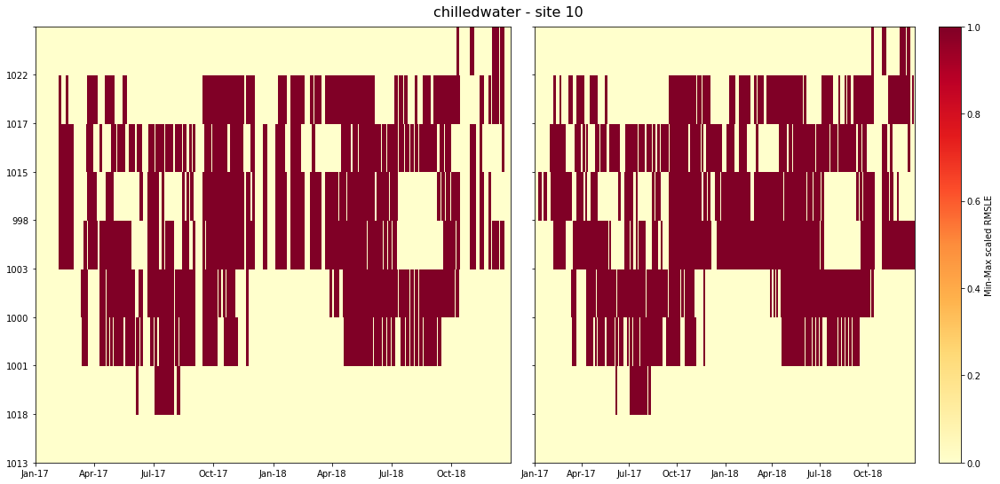

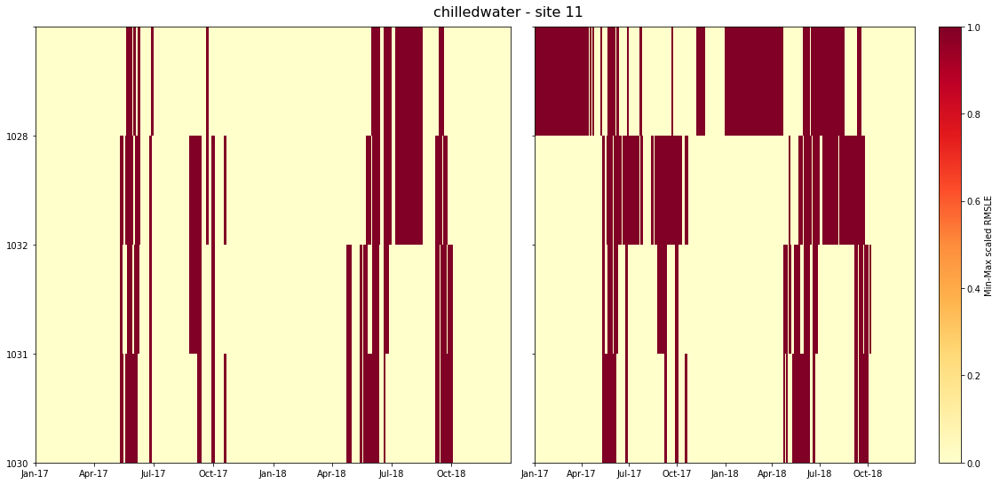

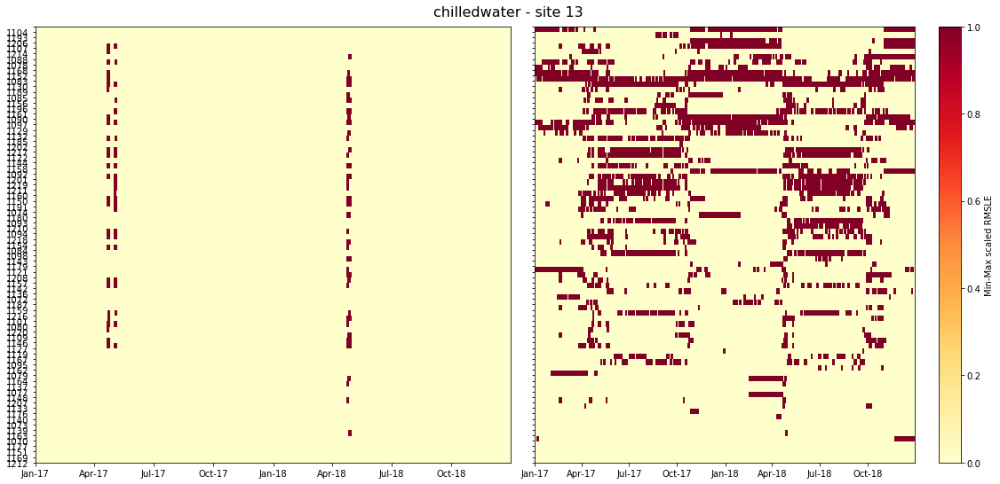

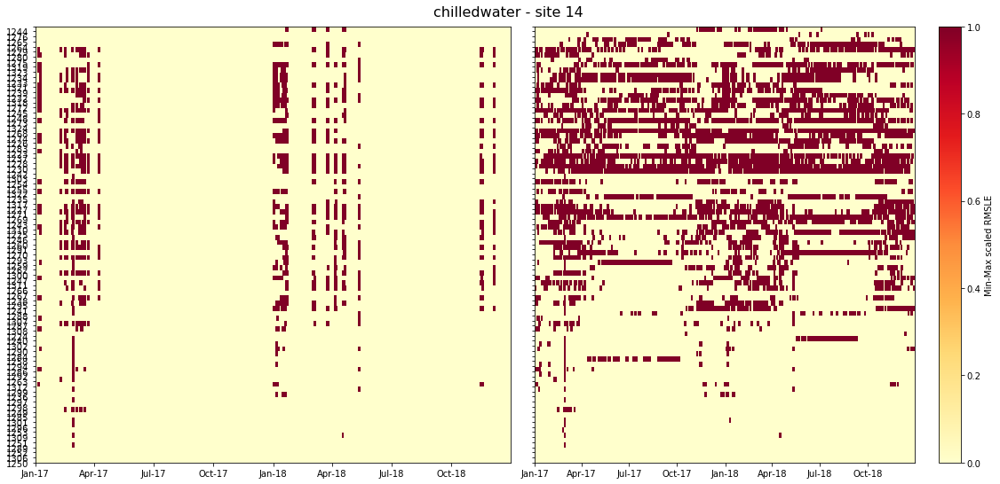

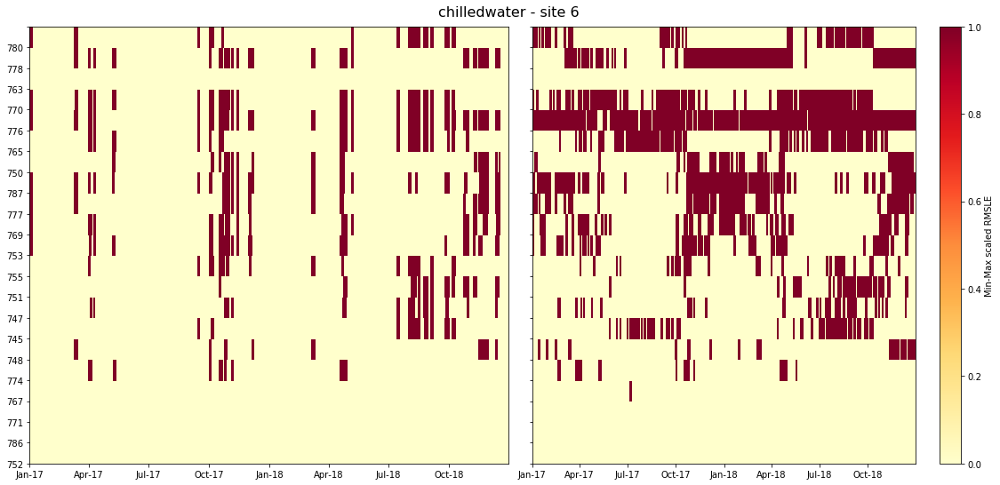

...

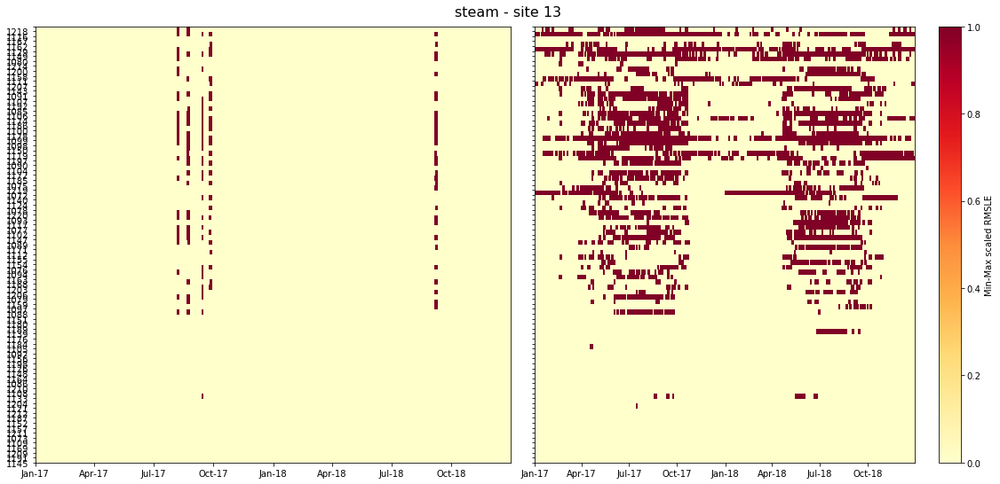

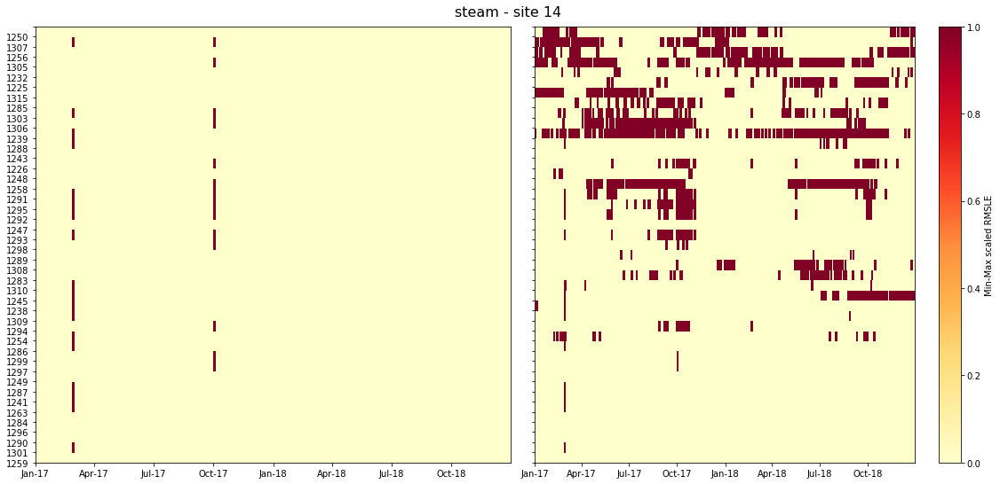

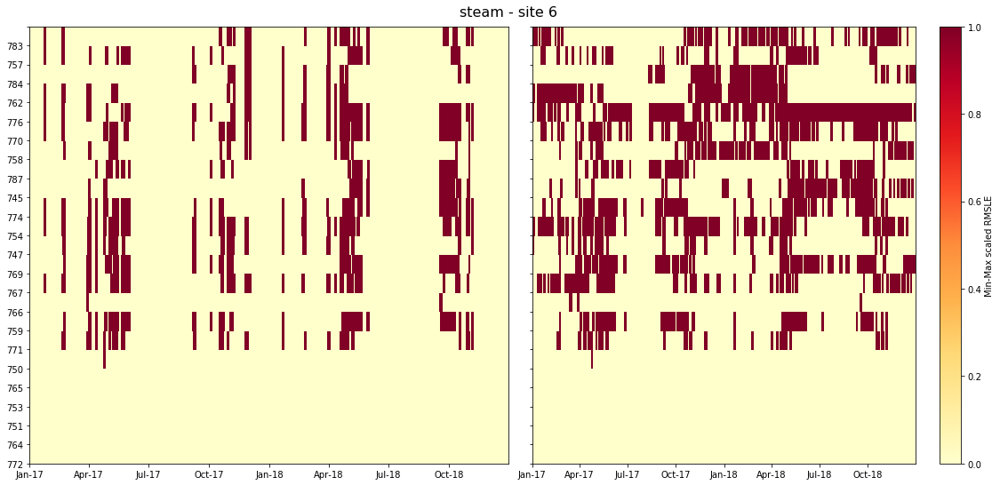

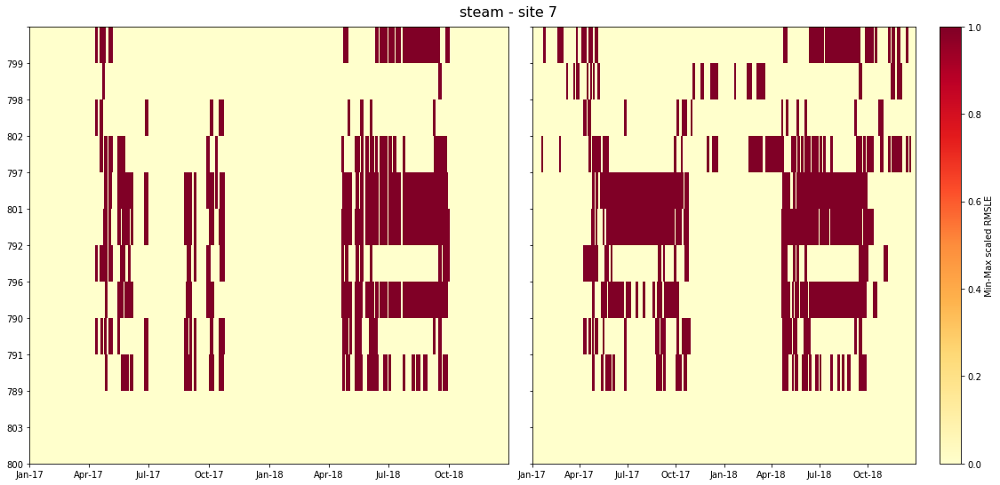

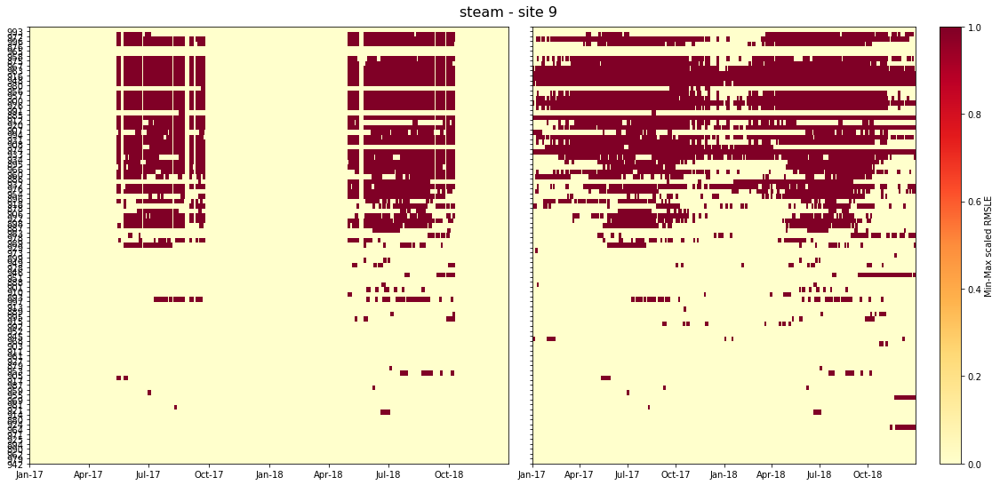

In [9]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_A1_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB1(file, meter, 0.33, 3, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_C1_site{site}.csv")

    print()

## C2

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



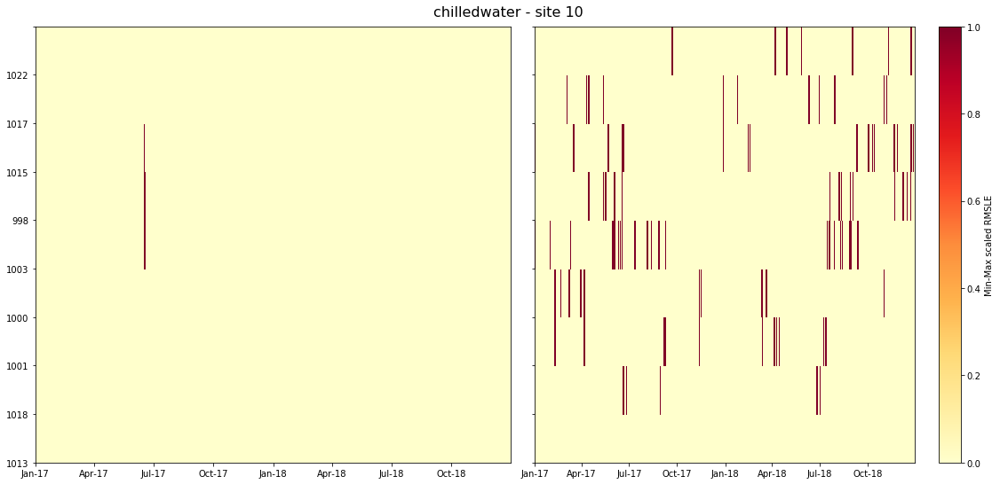

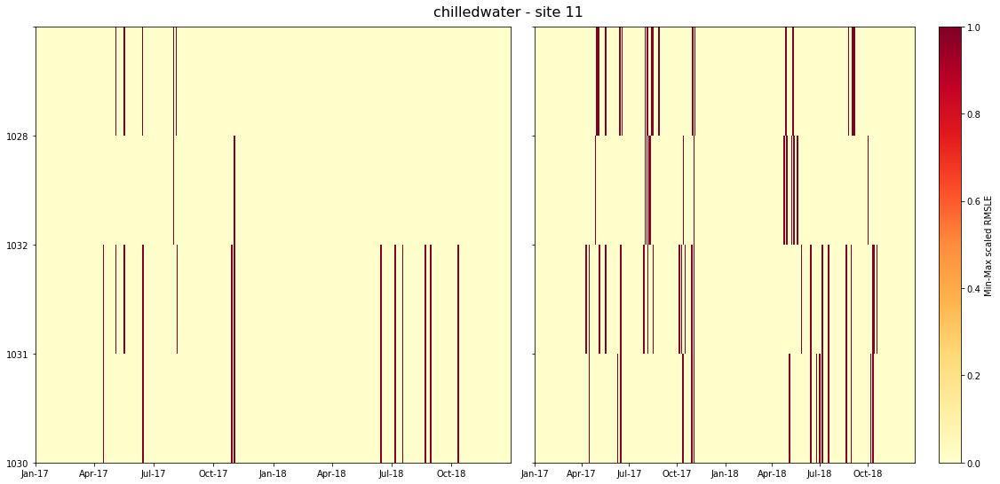

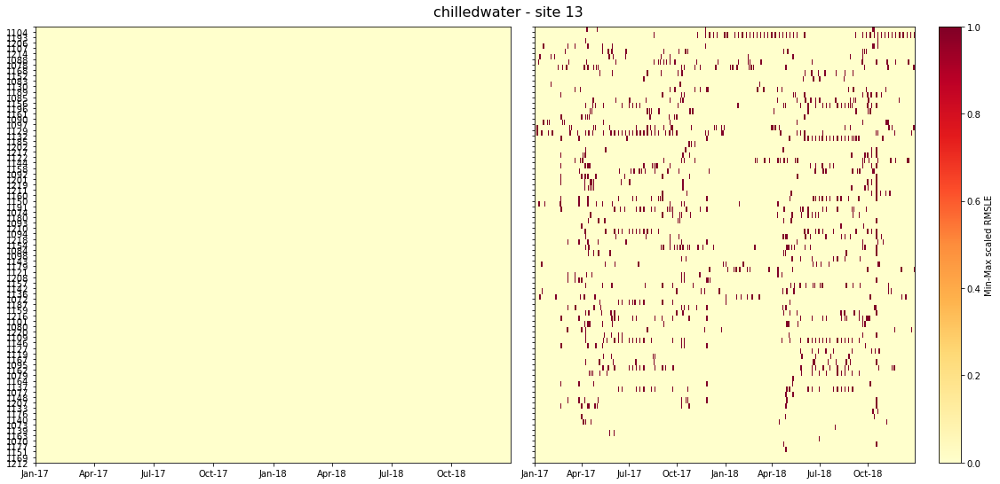

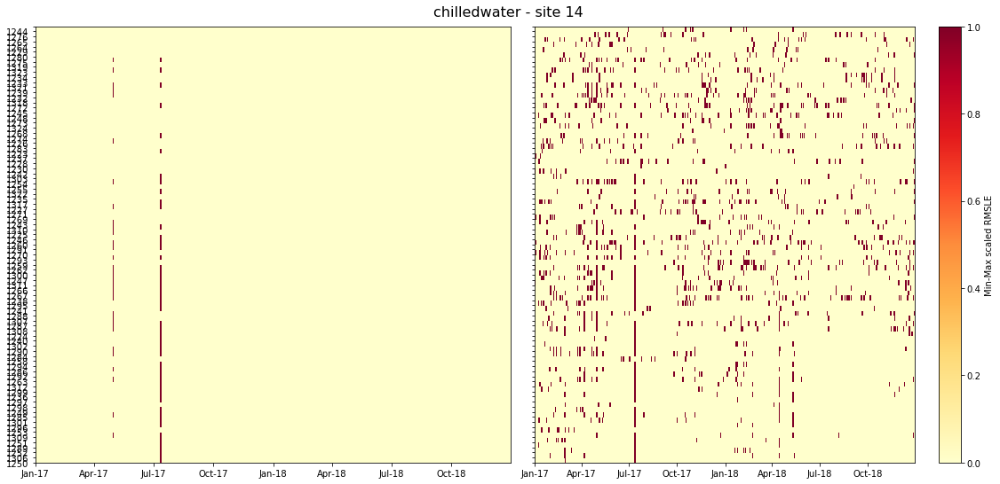

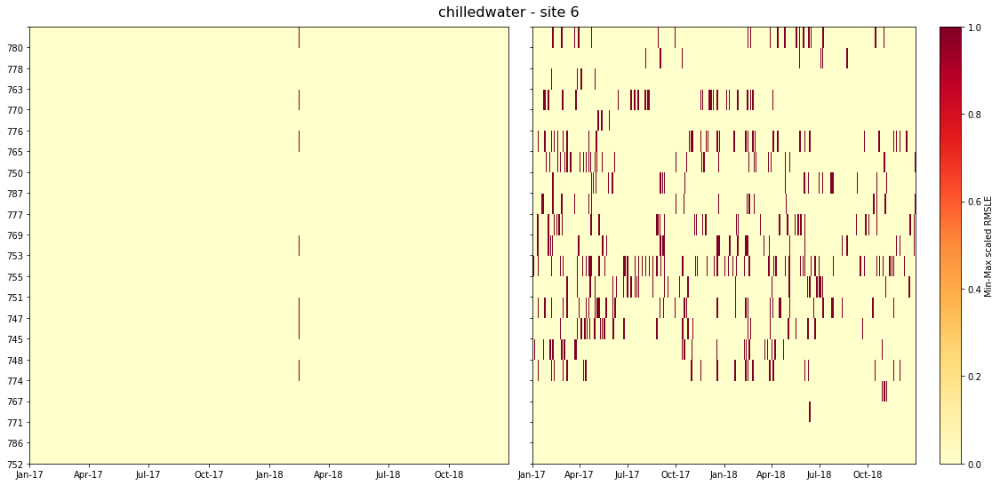

...

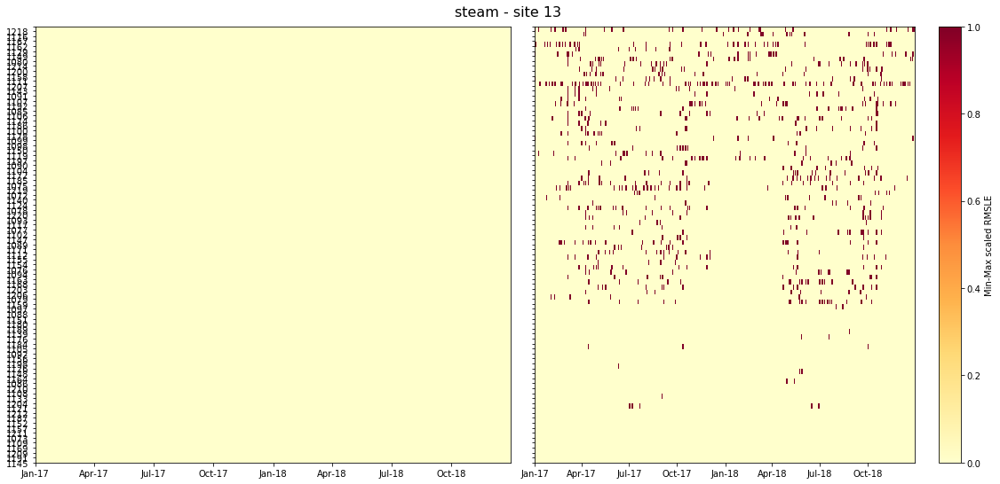

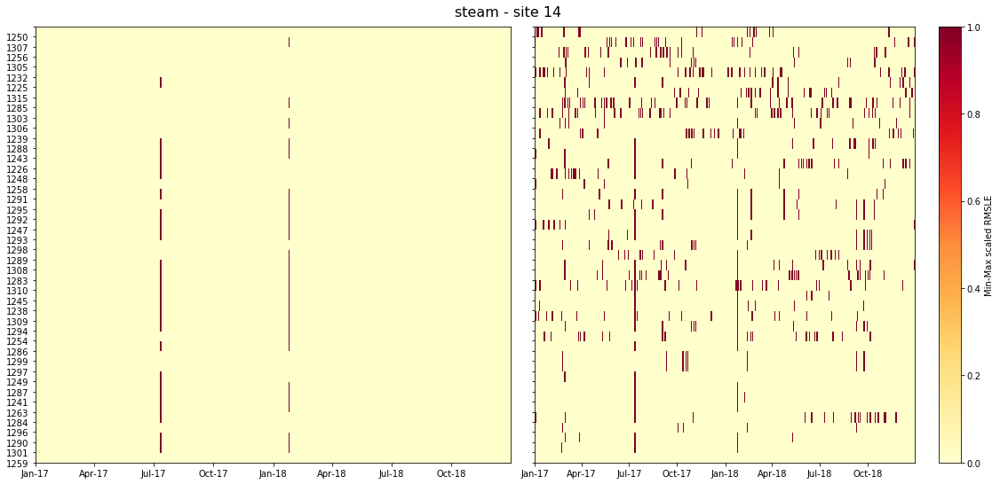

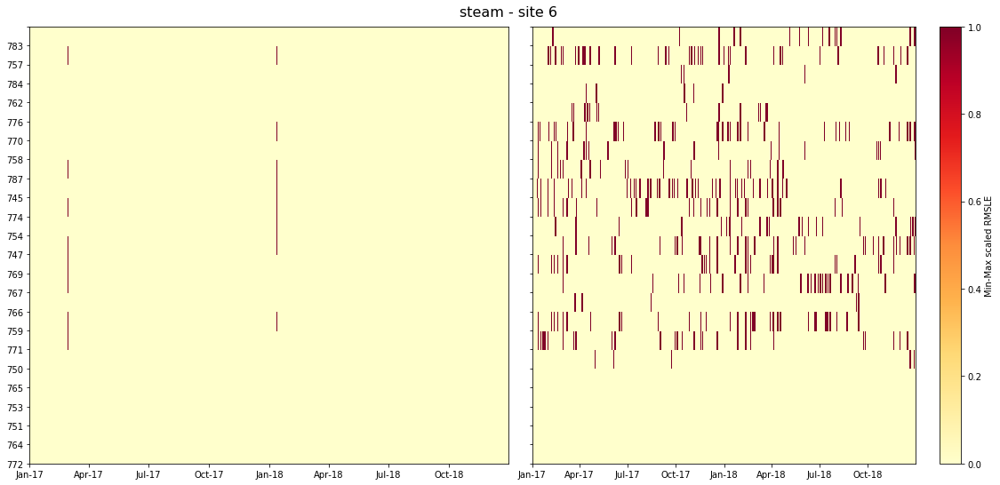

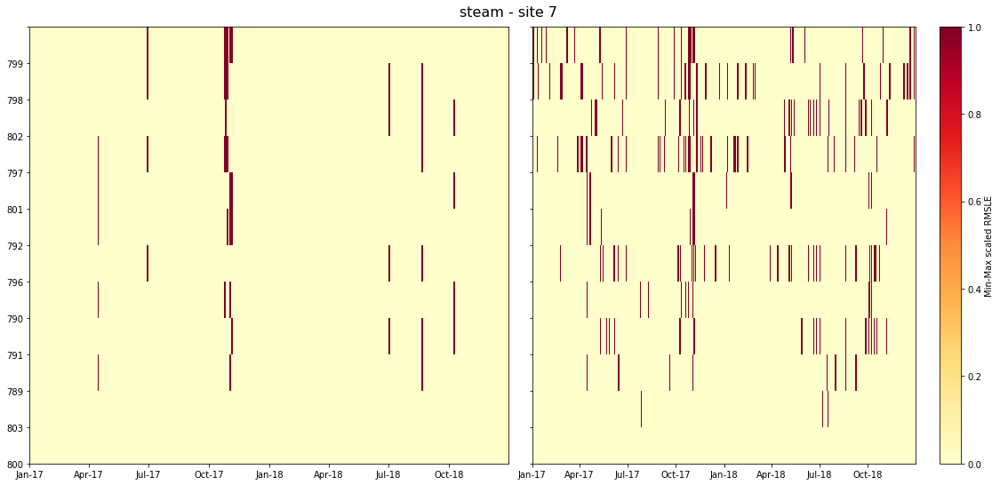

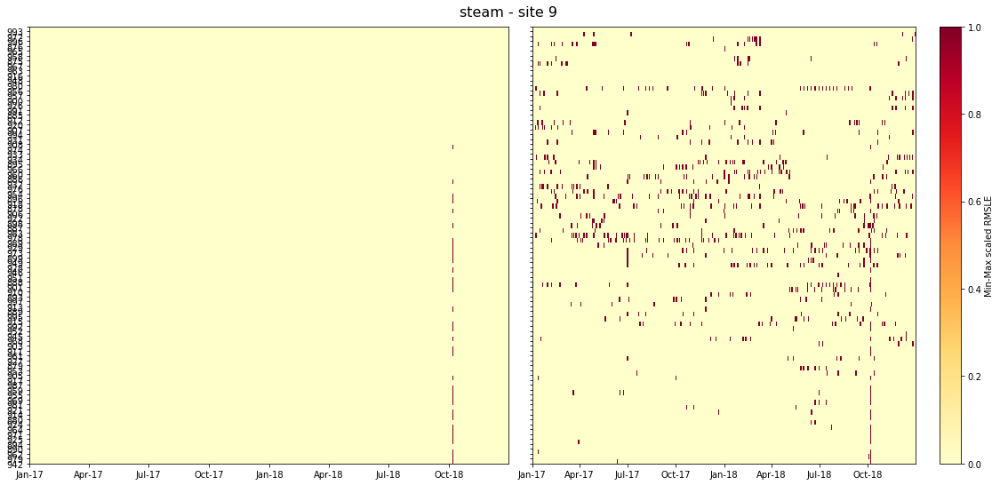

In [10]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_A2_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB2(file, meter, 0.33, 3, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_C2_site{site}.csv")

    print()

## C3

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



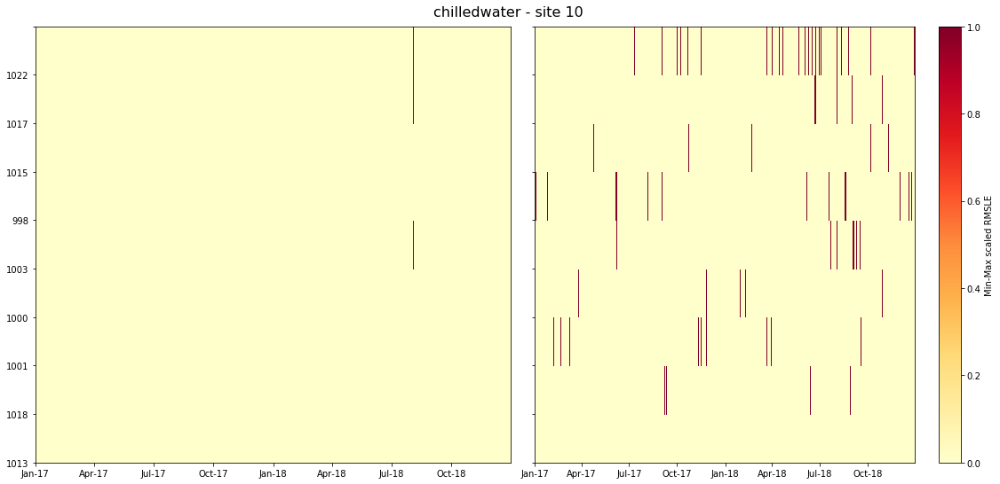

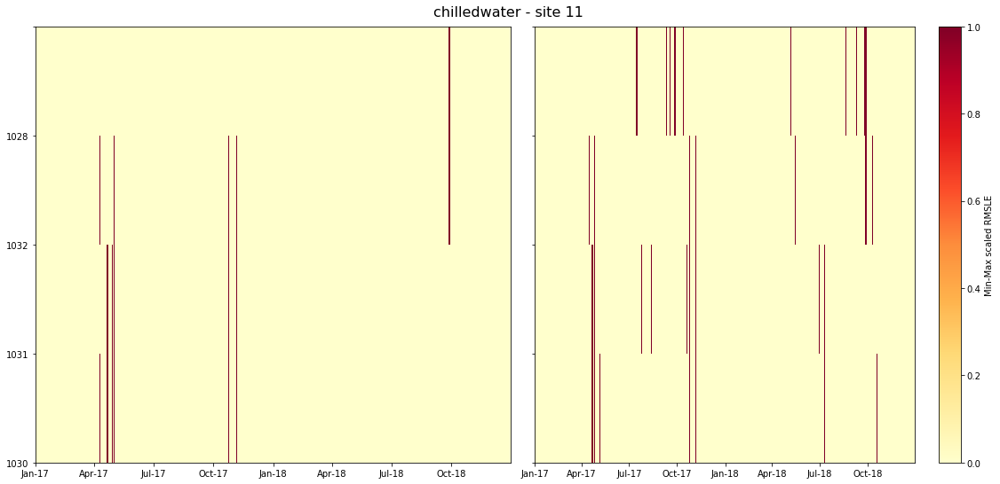

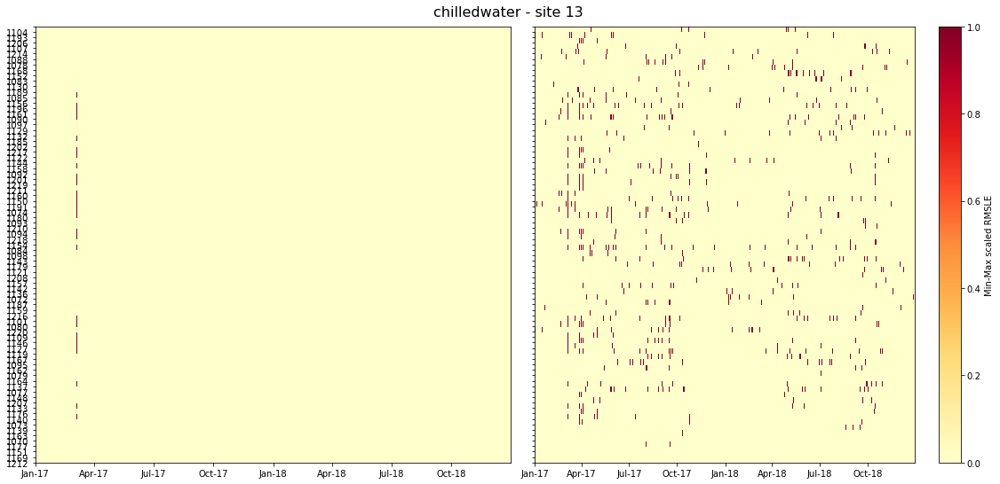

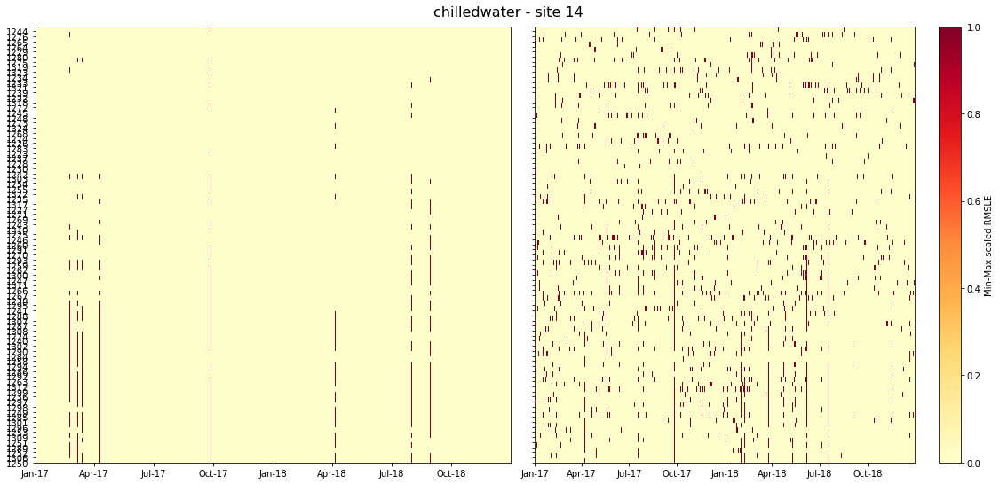

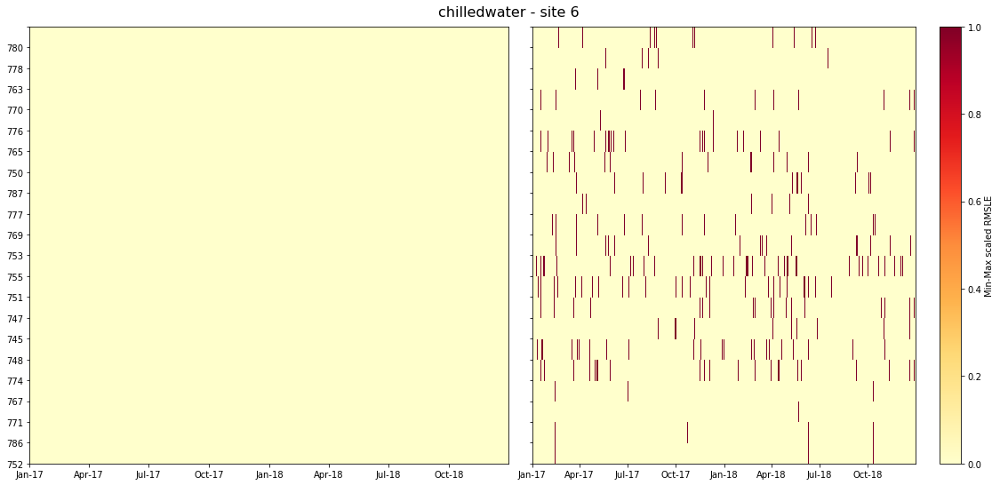

...

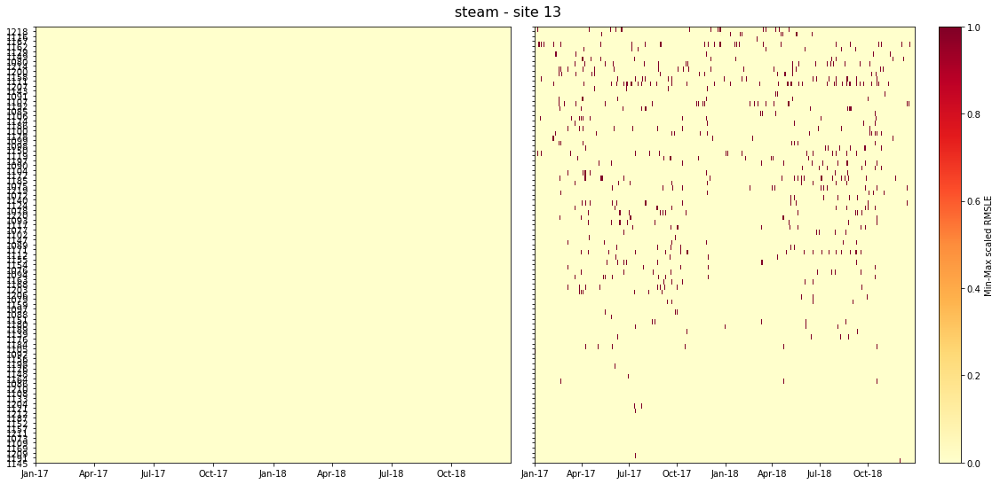

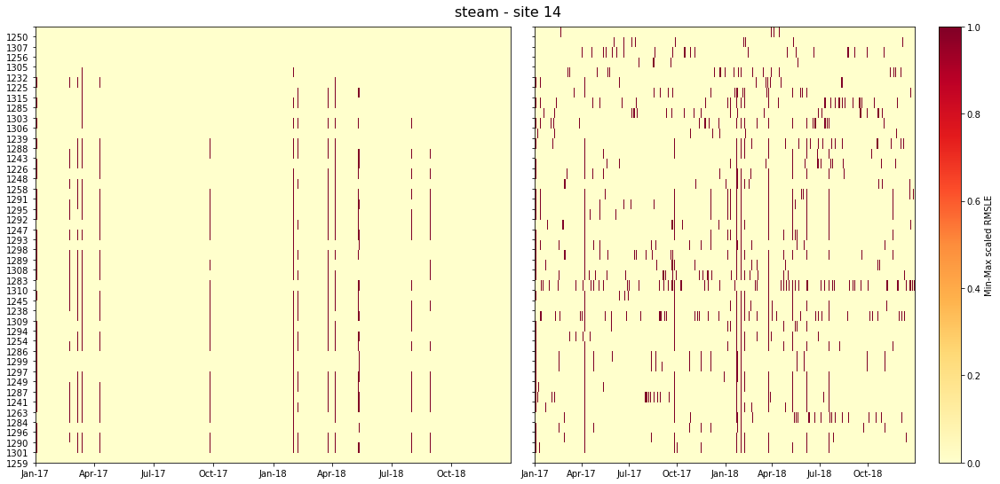

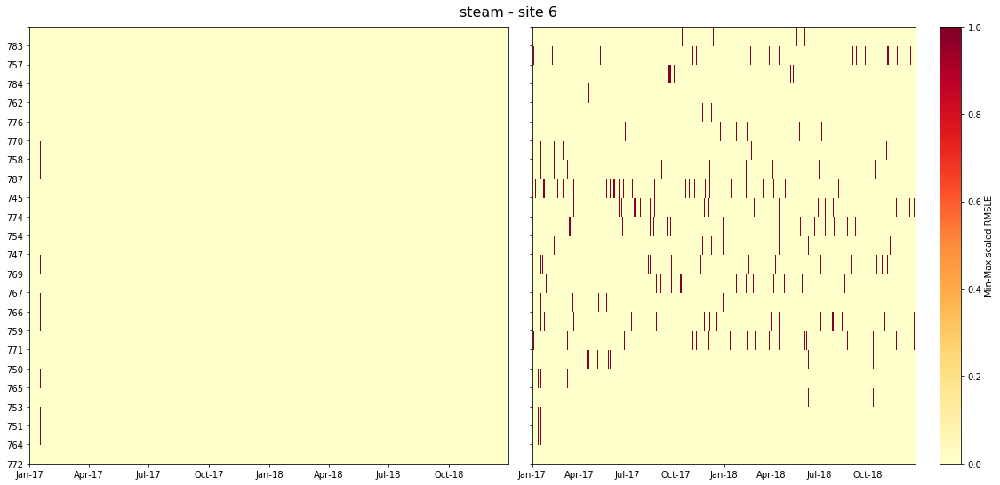

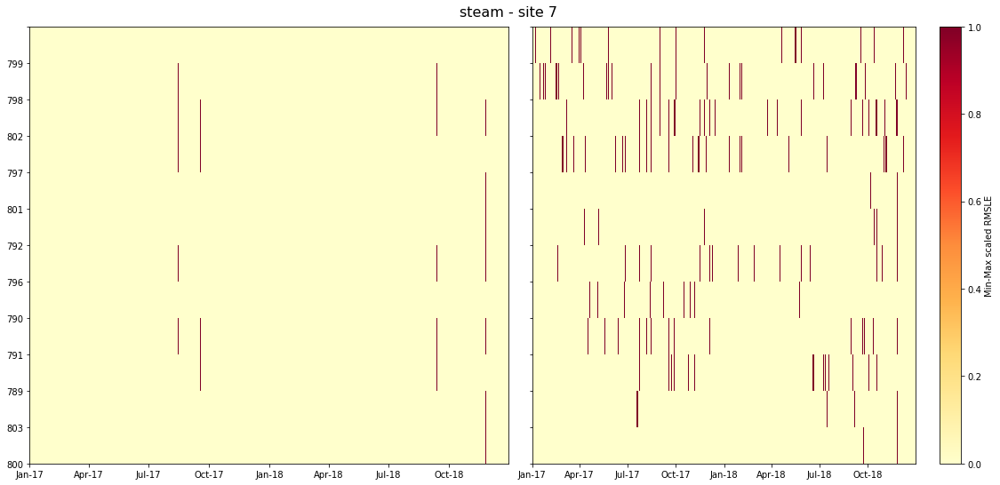

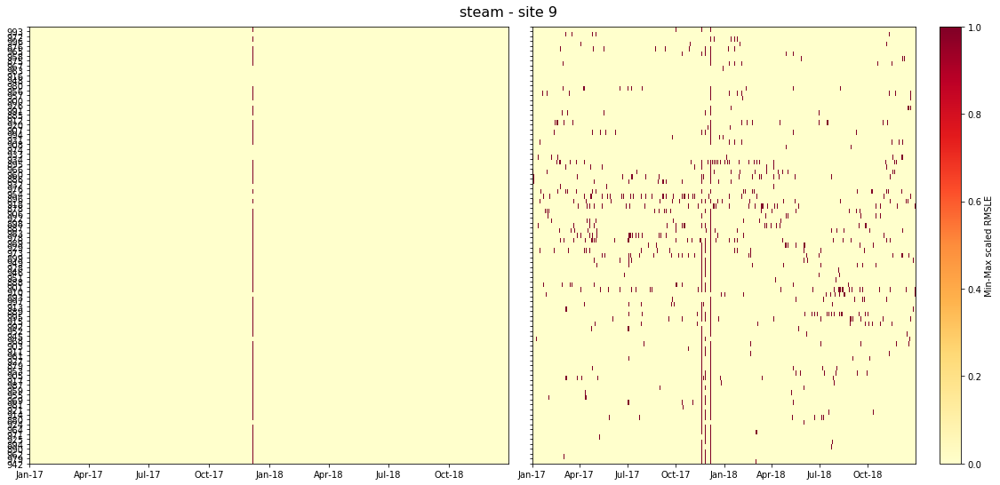

In [9]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_A3_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB3(file, meter, 0.33, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_C3_site{site}.csv")

    print()

## C4

In [96]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_A4_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB4(file, meter, 0.33, 30, 0.1, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_C4_site{site}.csv")

    print()

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



# Out of range errors (D)

## D1

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



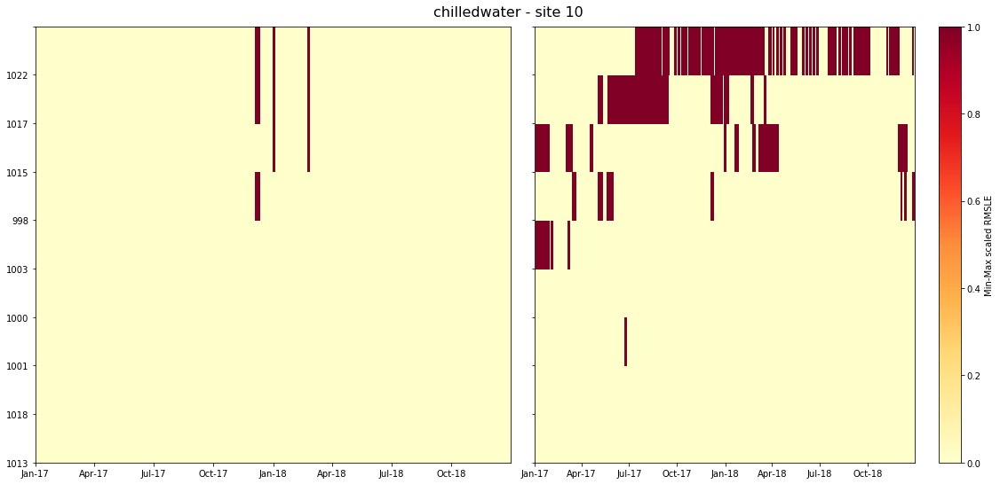

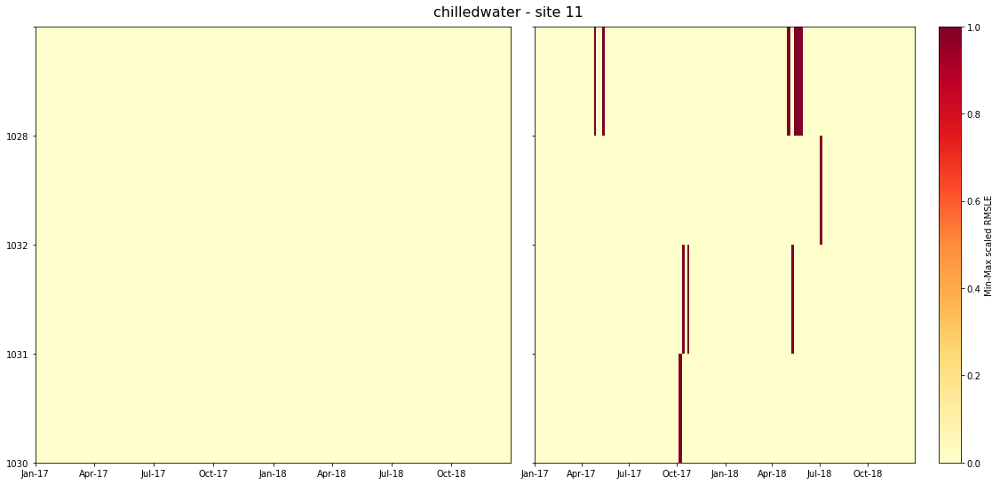

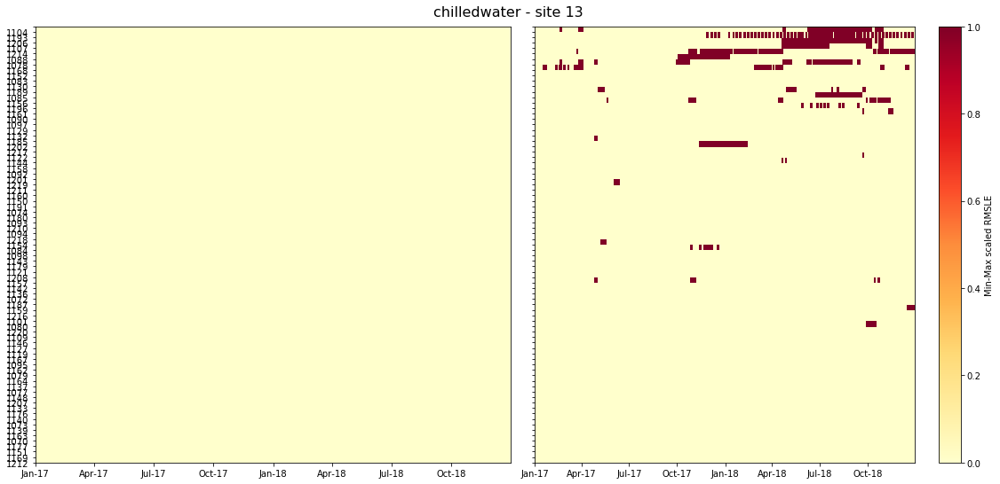

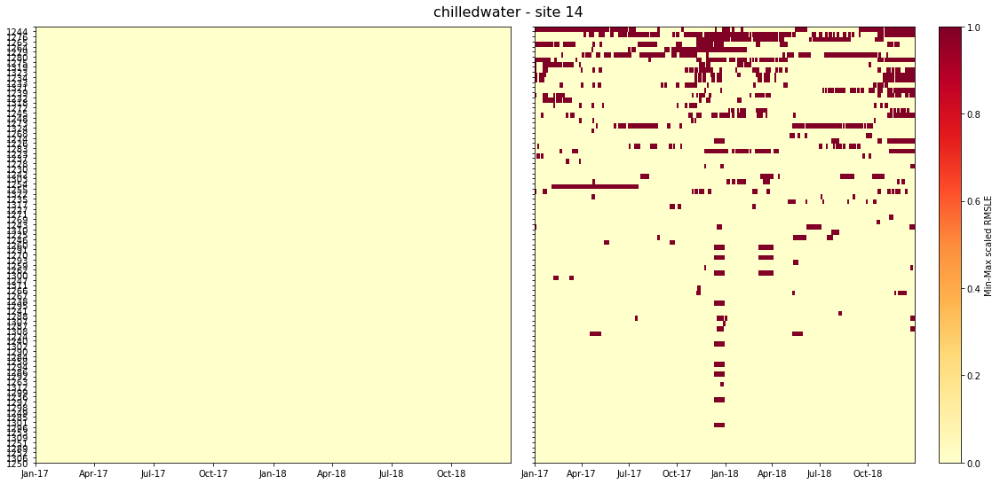

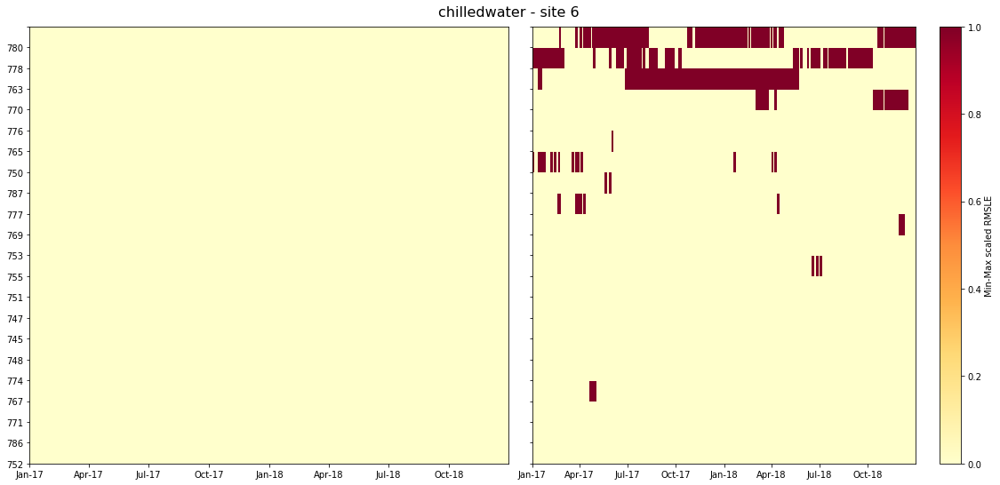

...

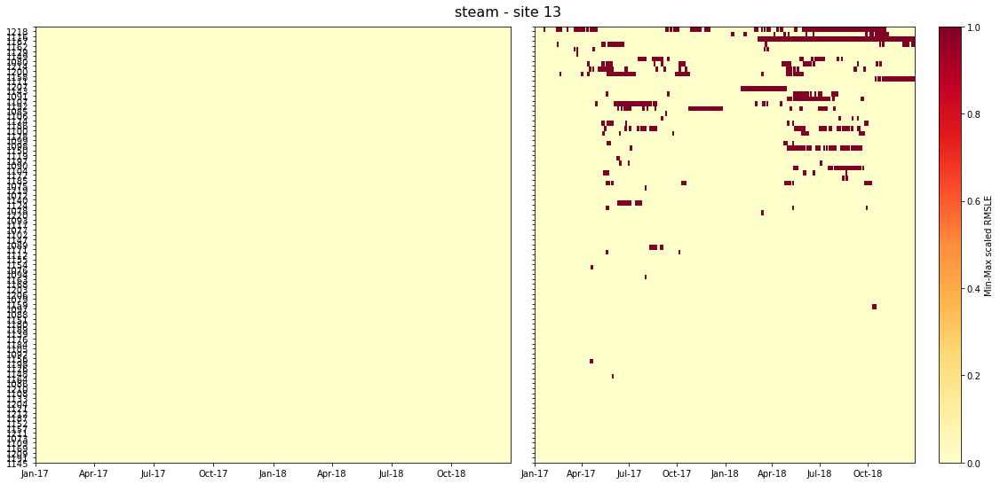

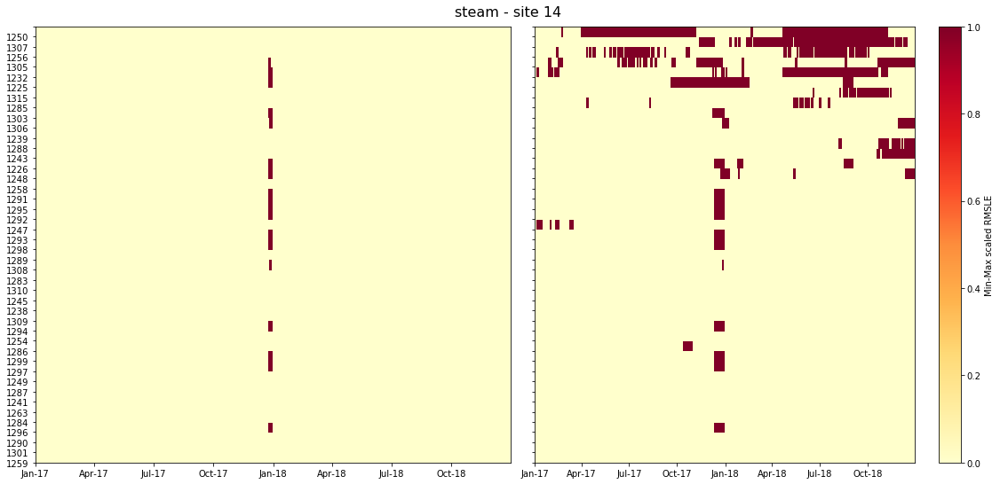

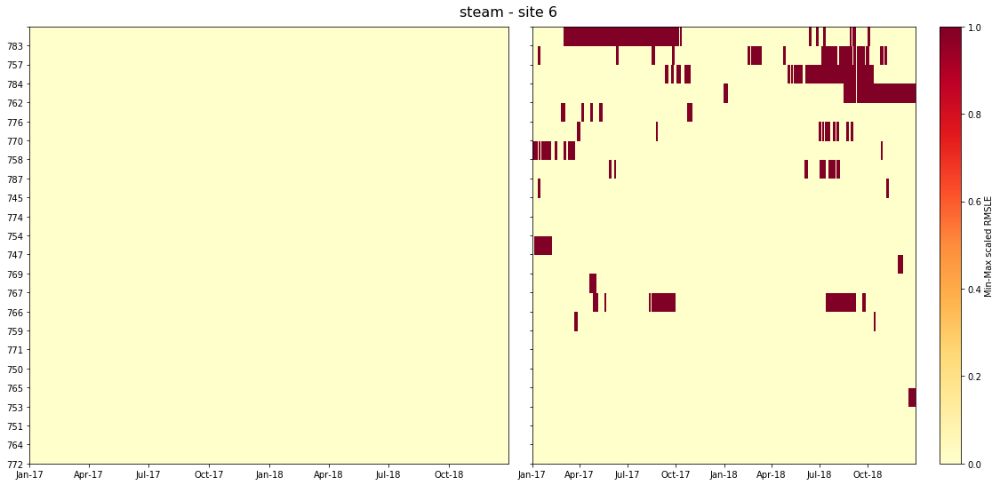

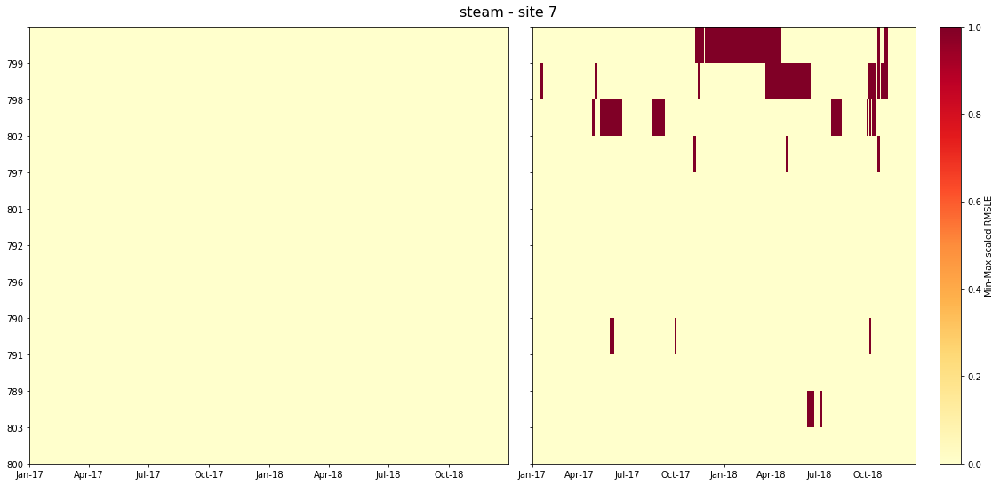

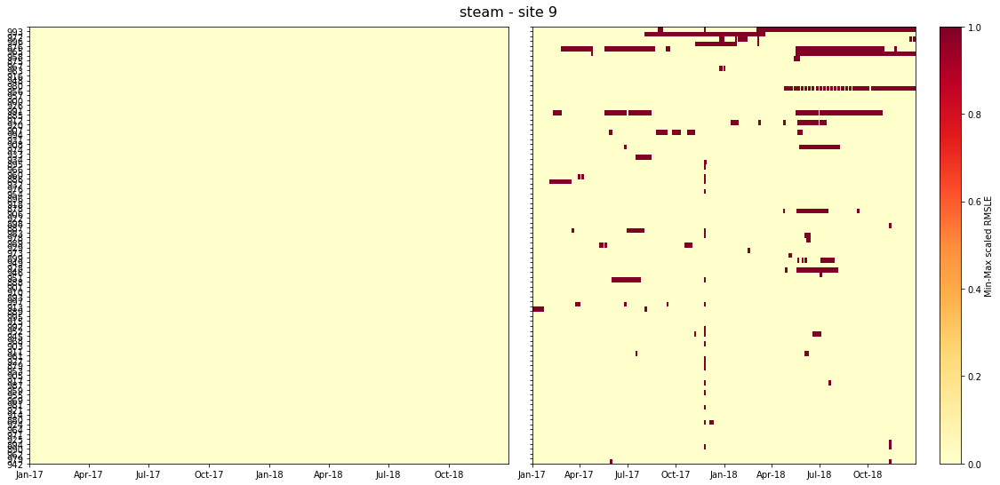

In [11]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_B1_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB1(file, meter, 0.33, 3, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_D1_site{site}.csv")

    print()

## D2

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



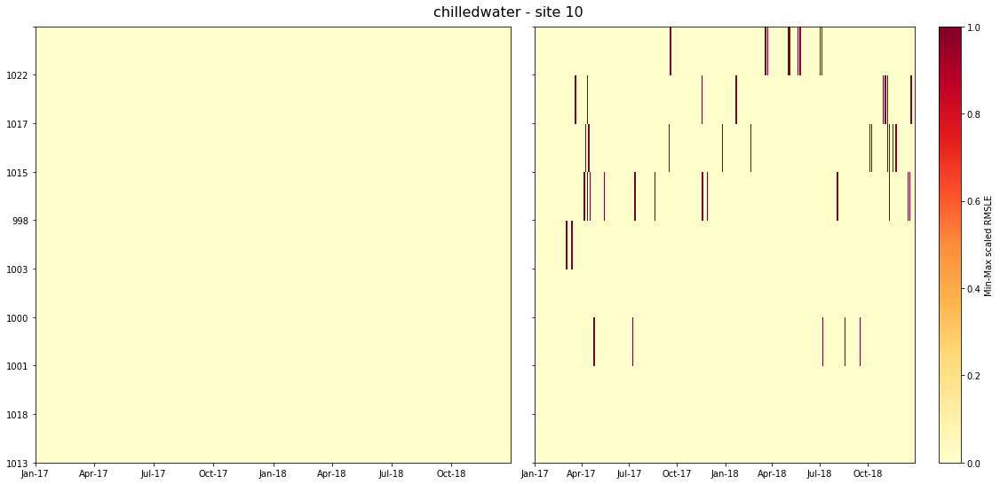

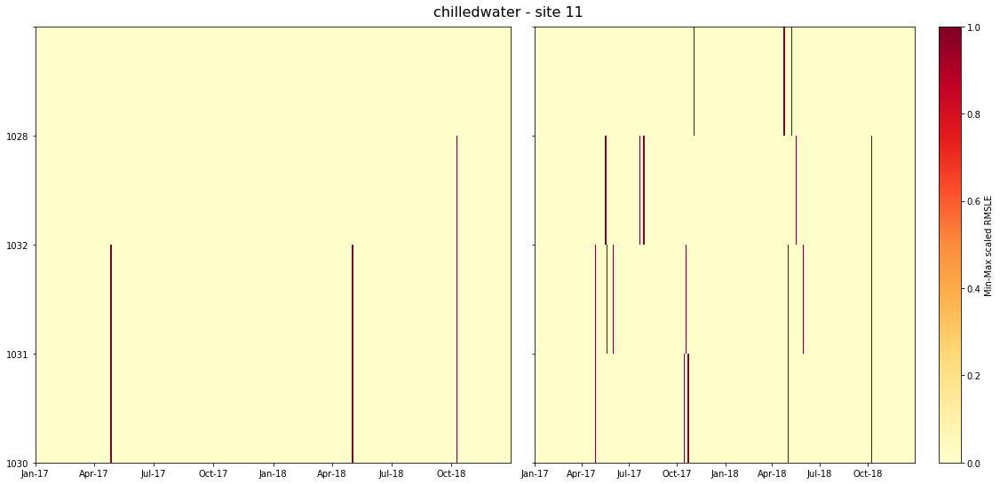

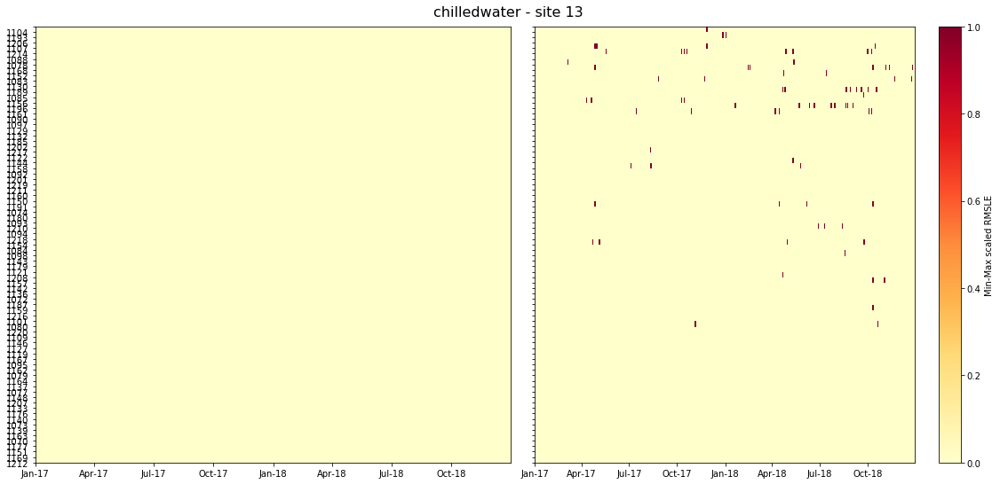

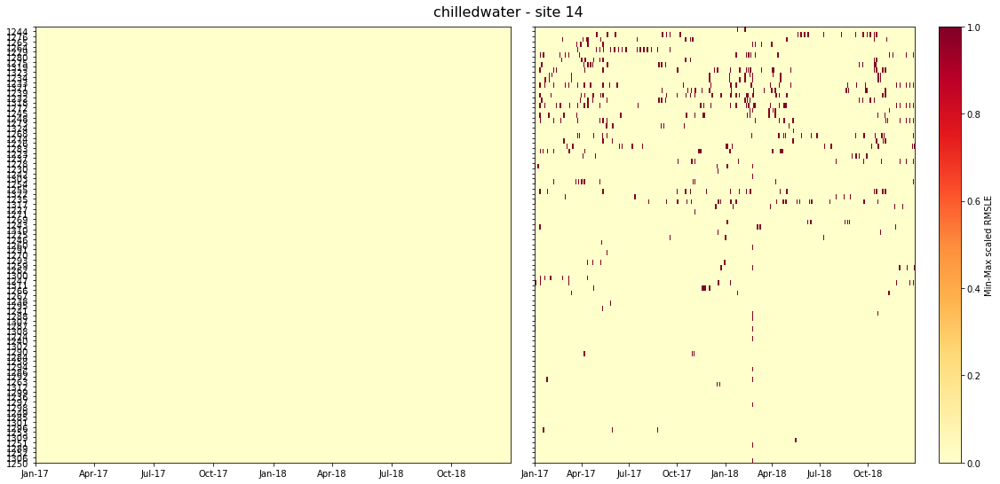

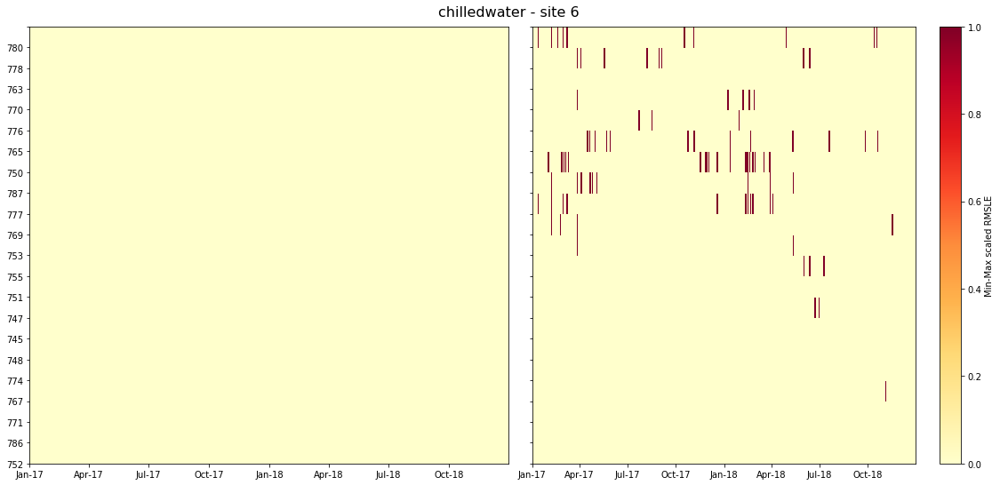

...

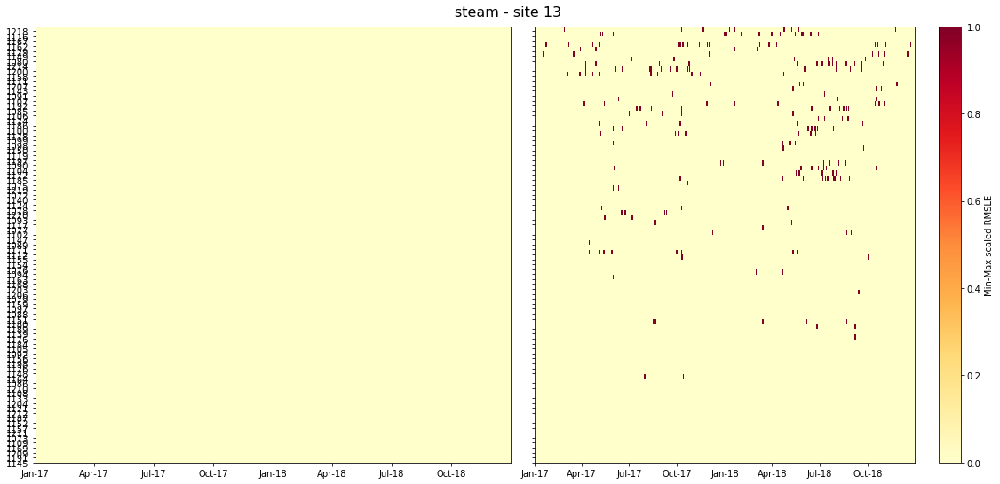

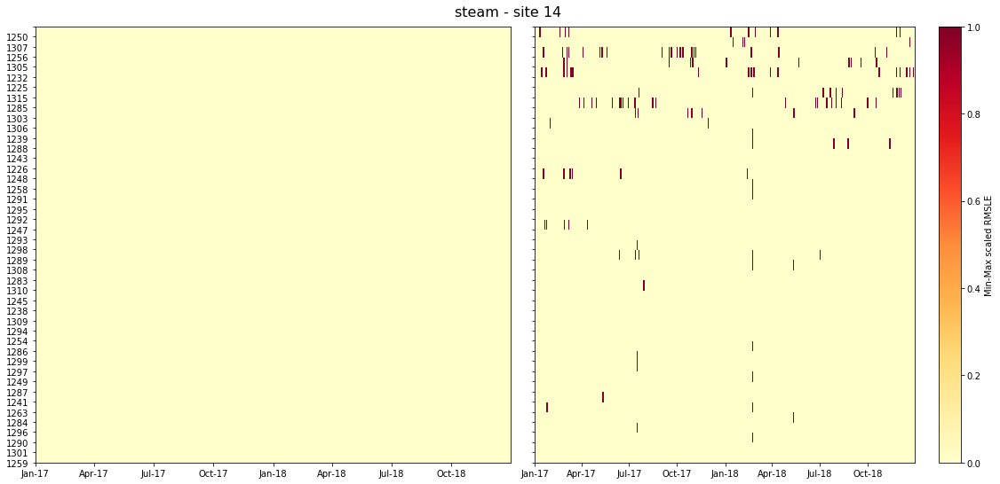

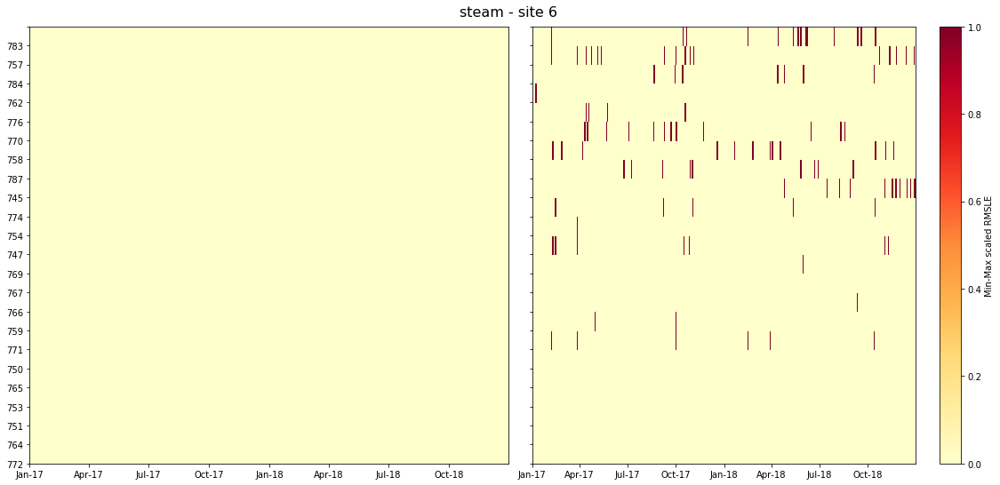

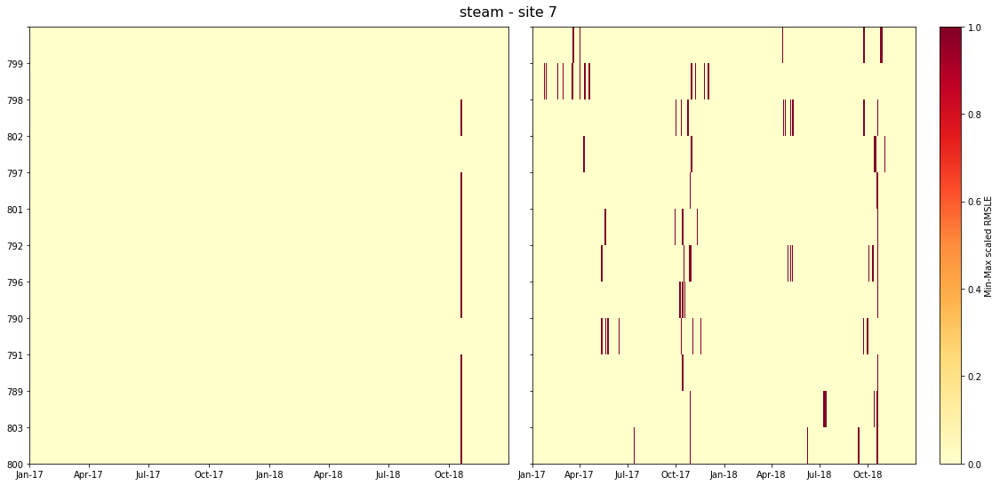

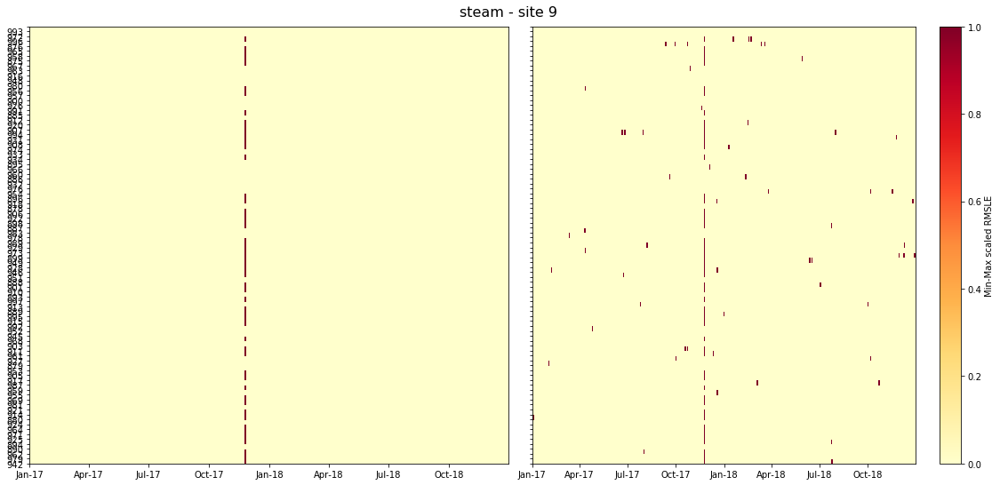

In [12]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_B2_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB2(file, meter, 0.33, 3, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_D2_site{site}.csv")

    print()

## D3

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9



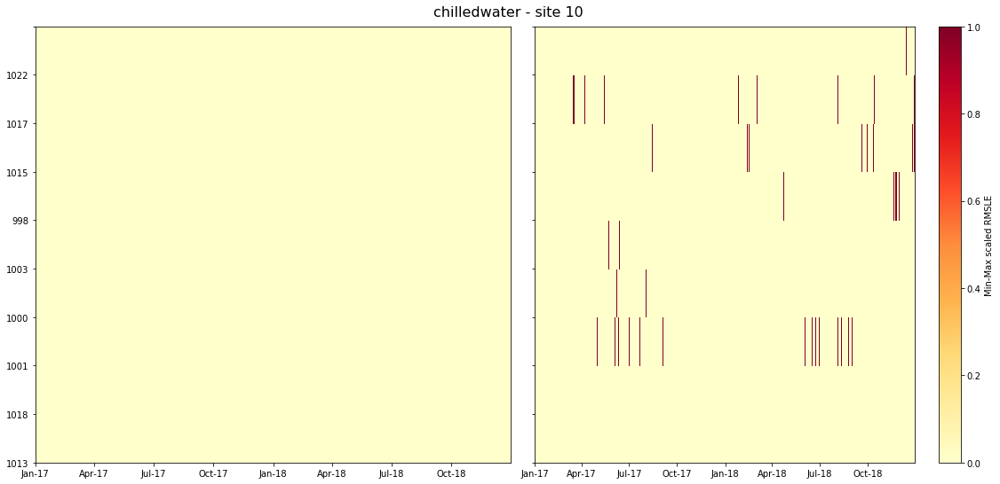

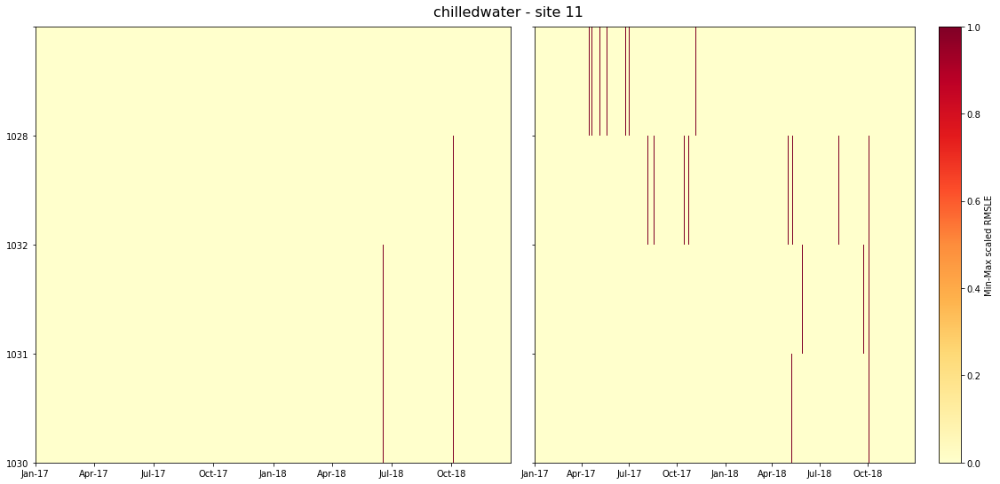

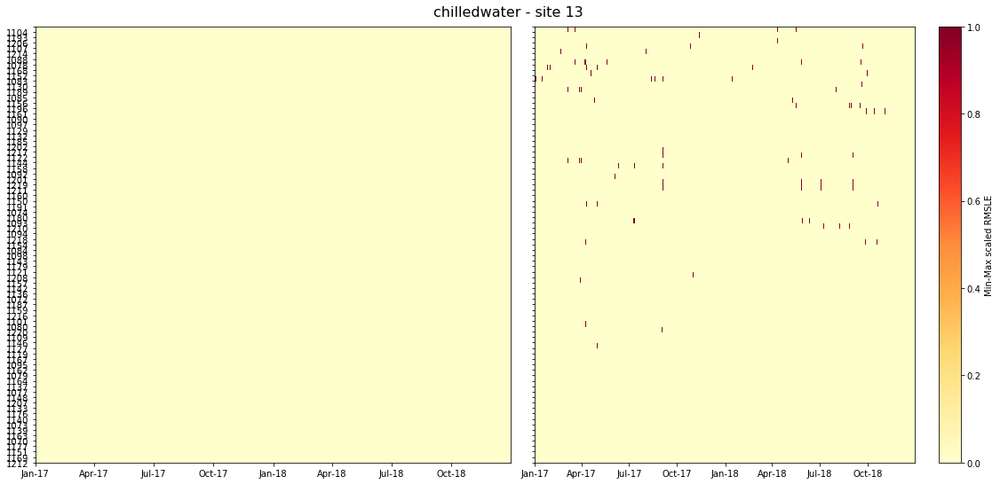

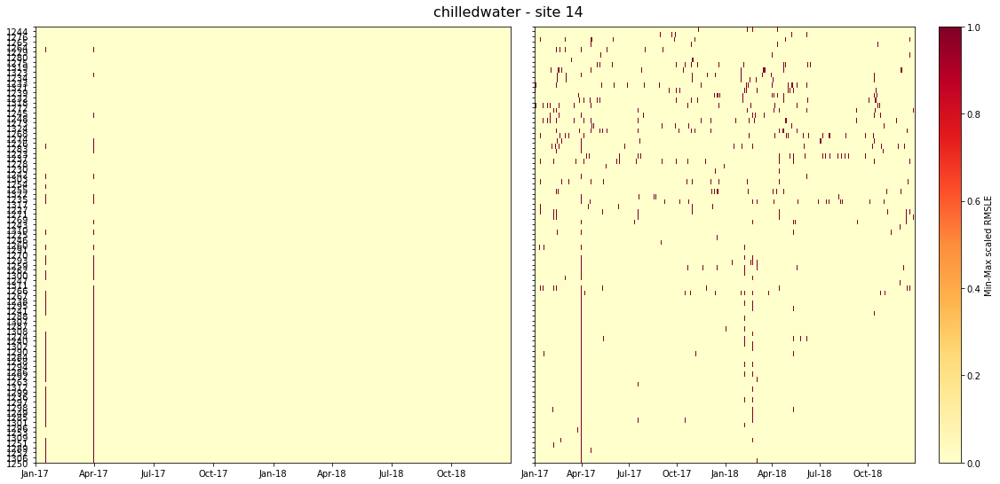

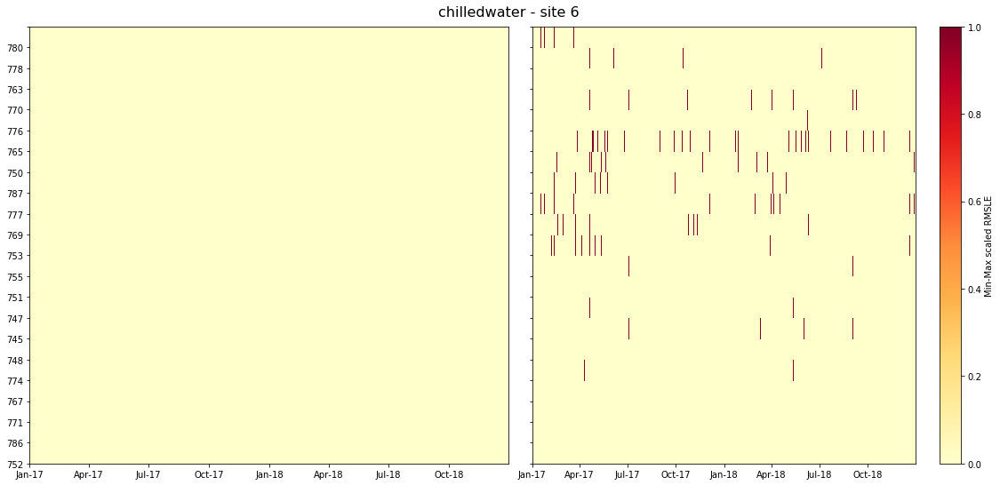

...

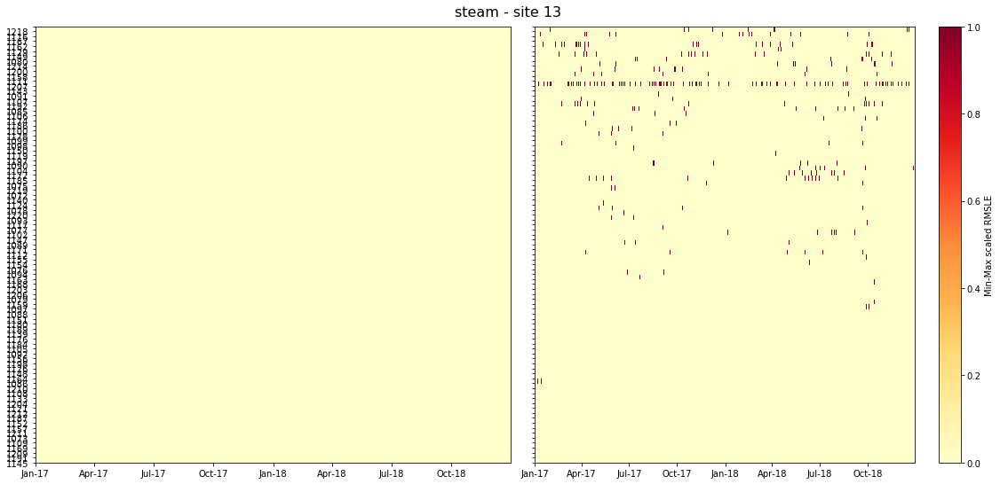

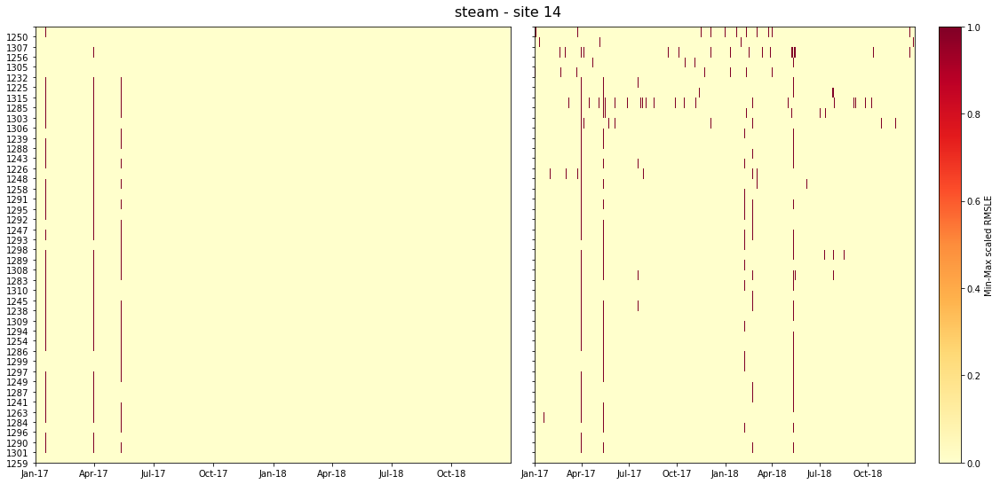

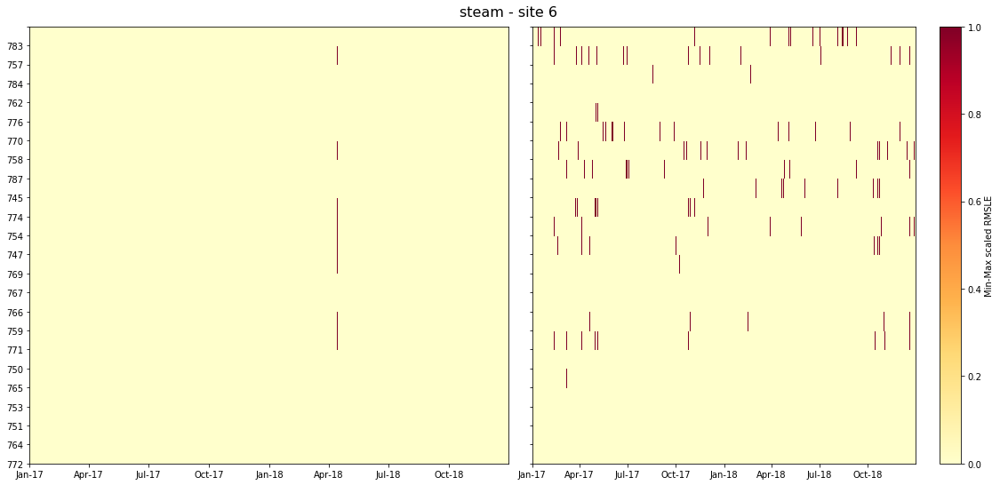

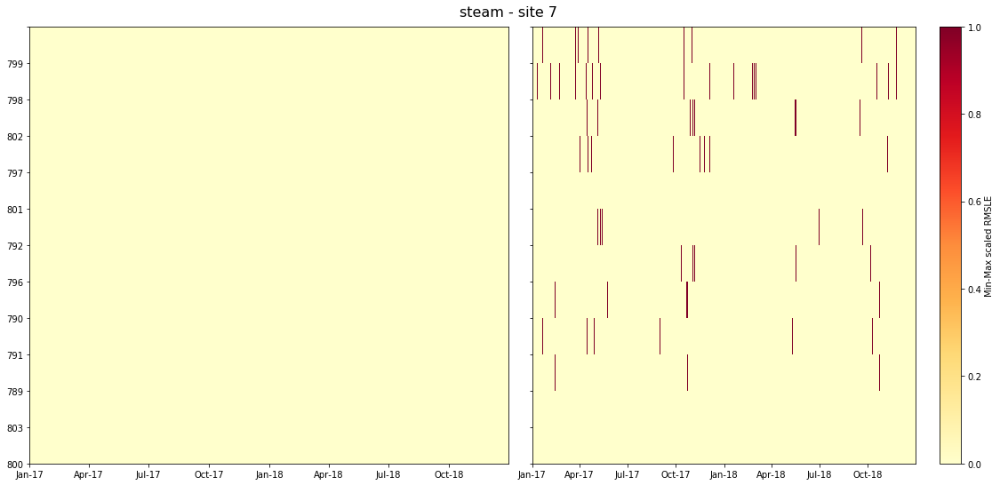

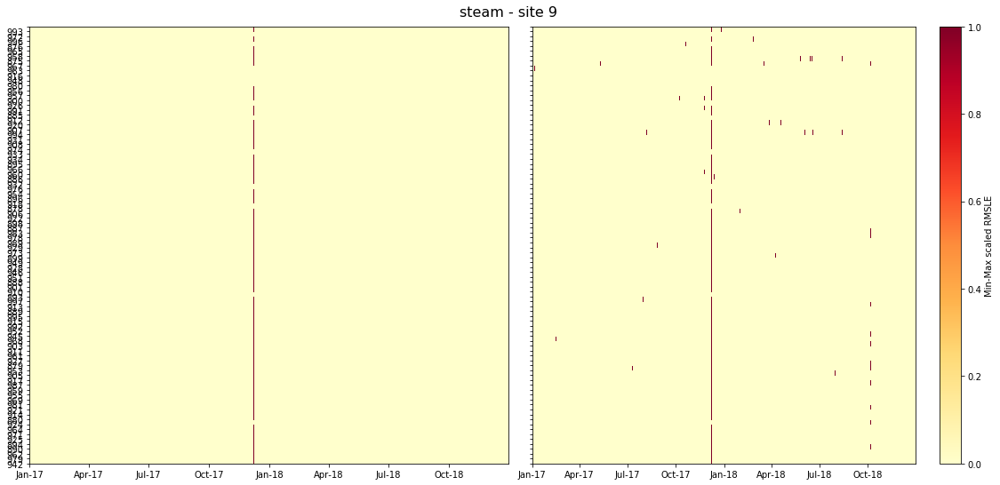

In [13]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_B3_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB3(file, meter, 0.33, plot=True)
        # Save df
        #df.to_csv(f"{path_res}\\{meter}_D3_site{site}.csv")

    print()

## D4

In [98]:
for meter in meters:
    #Get list of files
    files = glob.glob(path_res + f"{meter}_B4_*.csv")

    for file in files:
        # Site id
        site = file.split("\\")[-1].split("_")[-1].split(".")[0].split("site")[1]
        print(f"{meter} - site {site}")
        # Create df
        df = error_MB4(file, meter, 0.33, 30, 0.1, plot=False)
        # Save df
        df.to_csv(f"{path_res}\\{meter}_D4_site{site}.csv")

    print()

chilledwater - site 10
chilledwater - site 11
chilledwater - site 13
chilledwater - site 14
chilledwater - site 6
chilledwater - site 7
chilledwater - site 9

electricity - site 10
electricity - site 11
electricity - site 12
electricity - site 13
electricity - site 14
electricity - site 3
electricity - site 4
electricity - site 5
electricity - site 6
electricity - site 7
electricity - site 8
electricity - site 9

hotwater - site 1
hotwater - site 10
hotwater - site 11
hotwater - site 14
hotwater - site 7

steam - site 13
steam - site 14
steam - site 6
steam - site 7
steam - site 9

